<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Mieux connaître la consommation d’énergie en France</h1>

<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Import des librairies</h1>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Import des données</h1>

In [34]:
url_energie = 'https://opendata.agenceore.fr/explore/dataset/conso-elec-gaz-annuelle-par-secteur-dactivite-agregee-commune/download?format=csv&timezone=Europe/Berlin&use_labels_for_header=false'
url_siret = ''

In [36]:
df_energie = pd.read_csv(url_energie, sep=';')
#df_energie = pd.read_csv('conso-elec-gaz-annuelle-par-secteur-dactivite-agregee-commune.csv', sep=';')
df_departement = pd.read_csv('donnees_departements.csv', sep=';')

KeyboardInterrupt: 

In [21]:
df_departement.head()

,CODREG,REG,CODDEP,DEP,NBARR,NBCAN,NBCOM,PMUN,PTOT
0,84,Auvergne-Rhône-Alpes,01,Ain,4,23.0,393,657856,673801
1,32,Hauts-de-France,02,Aisne,5,21.0,799,529374,541176
2,84,Auvergne-Rhône-Alpes,03,Allier,3,19.0,317,335628,344455
3,93,Provence-Alpes-Côte d'Azur,04,Alpes-de-Haute-Provence,4,15.0,198,165451,170060
4,93,Provence-Alpes-Côte d'Azur,05,Hautes-Alpes,2,15.0,162,140605,144981


<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Carte interactive des consomations par départements</h1>

/var/folders/6r/gwp557492hbd4kyrbr9qggw80000gn/T/ipykernel_74970/2873042816.py:7: DtypeWarning:

Columns (25,27,29) have mixed types. Specify dtype option on import or set low_memory=False.



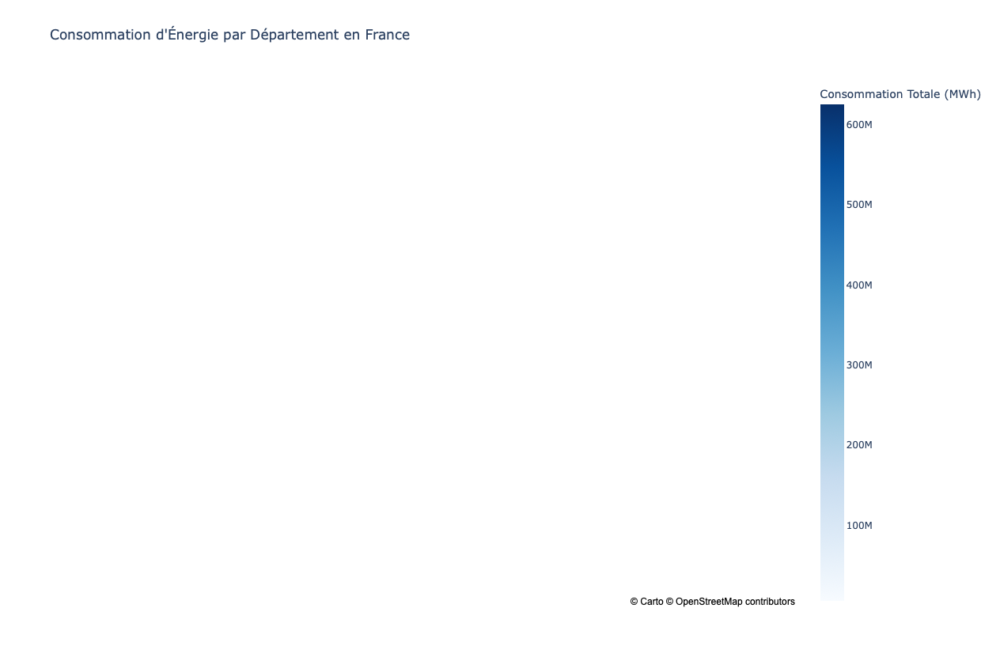

In [16]:
import geopandas as gpd
import pandas as pd
import plotly.express as px
import json

# Chargement des données de consommation d'énergie
data = pd.read_csv('conso-elec-gaz-annuelle-par-secteur-dactivite-agregee-commune.csv', sep=';')

# Assurez-vous que les codes de département dans les données de consommation sont des strings, au besoin ajoutez des zéros à gauche pour avoir deux caractères
data['code_departement'] = data['code_departement'].astype(str).str.zfill(2)

# Chargement du fichier GeoJSON pour les départements
departements_geojson_path = 'departements.geojson'
departements_geo_data = gpd.read_file(departements_geojson_path)

# Convertir les données GeoPandas en projection EPSG:4326 si nécessaire
departements_geo_data = departements_geo_data.to_crs(epsg=4326)

# Préparation des données de consommation d'énergie par département
data_departement = data.groupby('code_departement').agg({'consototale': 'sum'}).reset_index()

# Fusion des données GeoPandas avec les données de consommation
merged_departement_data = departements_geo_data.merge(data_departement, left_on='code', right_on='code_departement')

# Convertir le GeoDataFrame fusionné en GeoJSON pour l'utiliser dans Plotly
geojson = json.loads(merged_departement_data.to_json())

# La partie importante ici est d'assurer que l'argument 'featureidkey' est correctement défini pour correspondre aux propriétés de l'objet GeoJSON
fig_departements = px.choropleth_mapbox(merged_departement_data, 
                                        geojson=geojson, 
                                        locations='code_departement',  # Assurez-vous que c'est la colonne du code département
                                        color='consototale',
                                        featureidkey="properties.code",  # Ceci doit correspondre à la clé du GeoJSON
                                        mapbox_style="carto-positron",
                                        zoom=5, 
                                        center={"lat": 46.2276, "lon": 2.2137},
                                        title='Consommation d\'Énergie par Département en France',
                                        labels={'consototale': 'Consommation Totale (MWh)', 'code_departement': 'Département'},
                                        color_continuous_scale='Blues')

fig_departements.update_layout(height=850)
fig_departements.show()


Pourquoi ?

https://www.insee.fr/fr/statistiques/6797463#:~:text=Une%20forte%20dépendance%20régionale%20à%20l%27électricité%20et%20au%20gaz,-L%27industrie%20des&text=La%20région%20Hauts%2Dde%2DFrance,Grand%20Est%20(21%20%25).

/var/folders/6r/gwp557492hbd4kyrbr9qggw80000gn/T/ipykernel_74970/2487600522.py:7: DtypeWarning:

Columns (25,27,29) have mixed types. Specify dtype option on import or set low_memory=False.



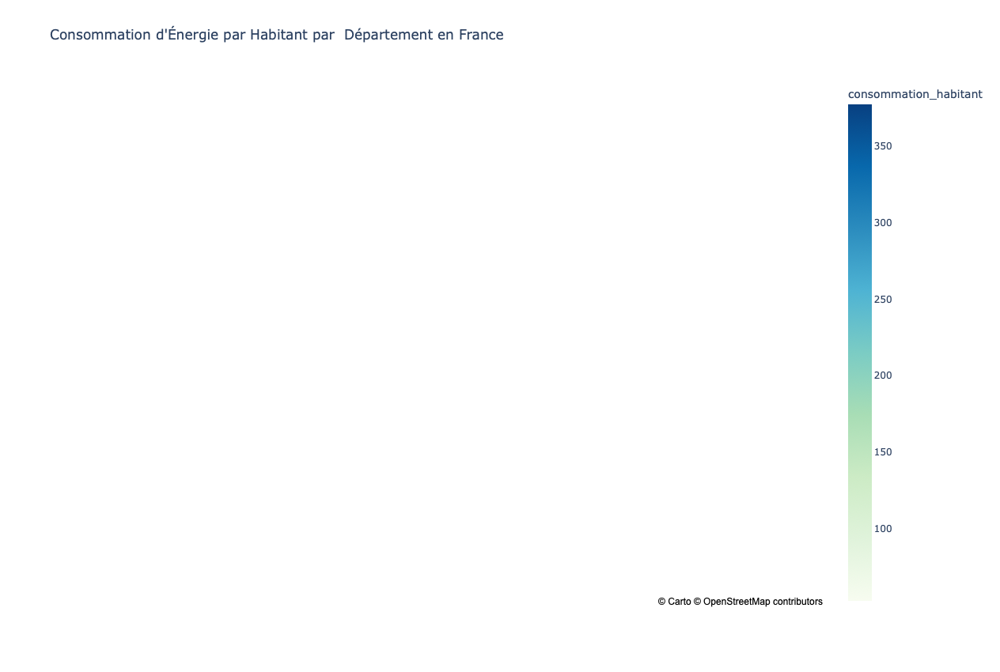

In [31]:
import geopandas as gpd
import pandas as pd
import plotly.express as px
import json

# Chargement des données de consommation d'énergie
data = pd.read_csv('conso-elec-gaz-annuelle-par-secteur-dactivite-agregee-commune.csv', sep=';')

data['code_departement'] = data['code_departement'].astype(str).str.zfill(2)

departements_geojson_path = 'departements.geojson'
departements_geo_data = gpd.read_file(departements_geojson_path)

# Convertir les données GeoPandas en projection EPSG:4326 si nécessaire
departements_geo_data = departements_geo_data.to_crs(epsg=4326)

# Préparation des données de consommation d'énergie par département
data_departement = data.groupby('code_departement').agg({'consototale': 'sum'}).reset_index()
data_departement['nb_habitant'] = df_departement['PTOT']

# Fusion des données GeoPandas avec les données de consommation
merged_departement_data = departements_geo_data.merge(data_departement, left_on='code', right_on='code_departement')
merged_departement_data['consommation_habitant'] = merged_departement_data['consototale']/merged_departement_data['nb_habitant']

# Convertir le GeoDataFrame fusionné en GeoJSON pour l'utiliser dans Plotly
geojson = json.loads(merged_departement_data.to_json())

# La partie importante ici est d'assurer que l'argument 'featureidkey' est correctement défini pour correspondre aux propriétés de l'objet GeoJSON
fig_departements = px.choropleth_mapbox(merged_departement_data, 
                                        geojson=geojson, 
                                        locations='code_departement',  # Assurez-vous que c'est la colonne du code département
                                        color='consommation_habitant',
                                        featureidkey="properties.code",  # Ceci doit correspondre à la clé du GeoJSON
                                        mapbox_style="carto-positron",
                                        zoom=5, 
                                        center={"lat": 46.2276, "lon": 2.2137},
                                        title='Consommation d\'Énergie par Habitant par  Département en France',
                                        labels={'consototale': 'Consommation Totale (MWh)', 'code_departement': 'Département'},
                                        color_continuous_scale='gnbu')

fig_departements.update_layout(height=850)
fig_departements.show()


<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Affichage des données vides pour chaque colonne</h1>

In [6]:
numerical_feature = [feature for feature in df_energie.columns if df_energie[feature].dtypes != 'O']
print('Variables numérique : ',len(numerical_feature))
df_energie[numerical_feature].head()

Variables numérique :  26


,annee,consoa,pdla,nombre_maille_secretisees_a,indquala,consoi,pdli,nombre_maille_secretisees_i,indquali,consot,...,indqualr,thermor,partr,consona,pdlna,nombre_maille_secretisees_na,indqualna,code_region,id_filiere,consototale
0,2021,0.0,0,0,0.0,0.00000,0,1,0.000,156.45858,...,0.0233,0.0,0.0,0.0,0,0,0.0,27,200,2317.51553
1,2021,0.0,0,0,0.0,0.00000,0,1,0.000,79.65285,...,0.3800,0.0,0.0,0.0,0,0,0.0,27,200,1905.29787
2,2021,0.0,0,0,0.0,1895.35634,9,0,0.111,6732.20104,...,0.3240,0.0,0.0,0.0,0,0,0.0,27,200,16756.07274
3,2021,0.0,0,0,0.0,0.00000,0,0,0.000,58.44242,...,0.0353,0.0,0.0,0.0,0,0,0.0,27,200,1696.15670
4,2021,0.0,0,1,0.0,0.00000,0,0,0.000,151.27263,...,0.0486,0.0,0.0,0.0,0,0,0.0,27,200,4395.90677


In [7]:
discrete_feature = [feature for feature in numerical_feature if len(df_energie[feature].unique())<25]
print('Variables discrete :{}'.format(len(discrete_feature)))

Variables discrete :5


In [8]:
continuous_feature = [feature for feature in numerical_feature if  feature not in discrete_feature]
print('Variable continues : {}'.format(len(continuous_feature)))

Variable continues : 21


In [9]:
categorical_feature = [feature for feature in df_energie.columns if df_energie[feature].dtypes=='O']
categorical_feature

['operateur',
 'filiere',
 'code_commune',
 'libelle_commune',
 'code_epci',
 'libelle_epci',
 'code_departement',
 'libelle_departement',
 'libelle_region',
 'code_postal']

<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Consommation d'Énergie par Secteur et par Année</h1>

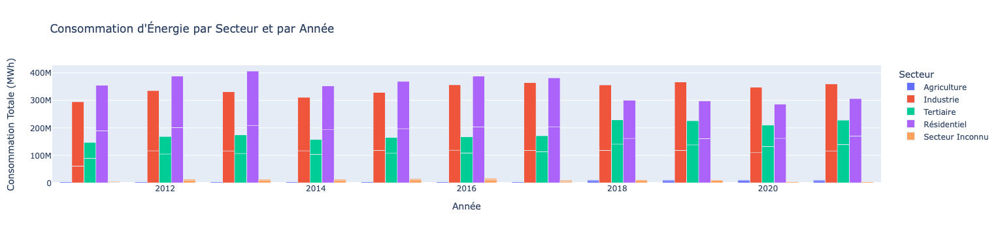

In [10]:
import plotly.express as px
import pandas as pd

# Assurez-vous de charger vos données ici
# data = pd.read_csv('chemin_vers_votre_fichier.csv')

# Calcul de la consommation totale par secteur et par année
sector_consumption_yearly = df_energie.groupby(['annee', 'filiere']).agg({
    'consoa': 'sum',
    'consoi': 'sum',
    'consot': 'sum',
    'consor': 'sum',
    'consona': 'sum'
}).reset_index()

# Préparation des données pour Plotly
sector_consumption_plotly = sector_consumption_yearly.melt(id_vars=['annee', 'filiere'], 
                                                           value_vars=['consoa', 'consoi', 'consot', 'consor', 'consona'],
                                                           var_name='Secteur', value_name='Consommation Totale (MWh)')

# Remplacer les noms des colonnes par des noms plus lisibles
sector_names = {'consoa': 'Agriculture', 'consoi': 'Industrie', 'consot': 'Tertiaire', 'consor': 'Résidentiel', 'consona': 'Secteur Inconnu'}
sector_consumption_plotly['Secteur'] = sector_consumption_plotly['Secteur'].map(sector_names)

# Créez un graphique à barres interactif
fig = px.bar(sector_consumption_plotly, x='annee', y='Consommation Totale (MWh)', color='Secteur', 
             barmode='group',
             title='Consommation d\'Énergie par Secteur et par Année',
             labels={'Consommation Totale (MWh)': 'Consommation Totale (MWh)', 'annee': 'Année', 'Secteur': 'Secteur'})

# Affichez le graphique
fig.show()


<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Consommation d'Énergie par Secteur, Filière et par Année</h1>

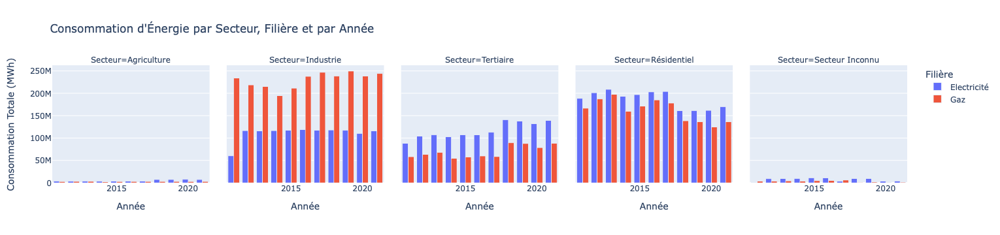

In [11]:
import plotly.express as px
import pandas as pd

# Assurez-vous de charger vos données ici
# data = pd.read_csv('chemin_vers_votre_fichier.csv')

# Calcul de la consommation totale par secteur, filière et année
sector_consumption_yearly = df_energie.groupby(['annee', 'filiere']).agg({
    'consoa': 'sum',
    'consoi': 'sum',
    'consot': 'sum',
    'consor': 'sum',
    'consona': 'sum'
}).reset_index()

# Préparation des données pour Plotly
sector_consumption_plotly = sector_consumption_yearly.melt(id_vars=['annee', 'filiere'], 
                                                           value_vars=['consoa', 'consoi', 'consot', 'consor', 'consona'],
                                                           var_name='Secteur', value_name='Consommation Totale (MWh)')

# Remplacer les noms des colonnes par des noms plus lisibles
sector_names = {'consoa': 'Agriculture', 'consoi': 'Industrie', 'consot': 'Tertiaire', 'consor': 'Résidentiel', 'consona': 'Secteur Inconnu'}
sector_consumption_plotly['Secteur'] = sector_consumption_plotly['Secteur'].map(sector_names)

# Créez un graphique à barres interactif
fig = px.bar(sector_consumption_plotly, x='annee', y='Consommation Totale (MWh)', color='filiere', 
             barmode='group', facet_col='Secteur',
             title='Consommation d\'Énergie par Secteur, Filière et par Année',
             labels={'Consommation Totale (MWh)': 'Consommation Totale (MWh)', 'annee': 'Année', 'Secteur': 'Secteur', 'filiere': 'Filière'})

# Affichez le graphique
fig.show()


<a id="1"></a>
<h1 style="background-color:white;
           padding:2%;
           font-family:newtimeroman;
           font-size:350%;
           text-align:center;
           border-radius: 5px;
           color:black;
           border:solid;
           border-color: black;">Tendances Annuelles de la Consommation d'Énergie par Filière</h1>

/var/folders/6r/gwp557492hbd4kyrbr9qggw80000gn/T/ipykernel_74970/3230277280.py:5: DtypeWarning:

Columns (25,27,29) have mixed types. Specify dtype option on import or set low_memory=False.



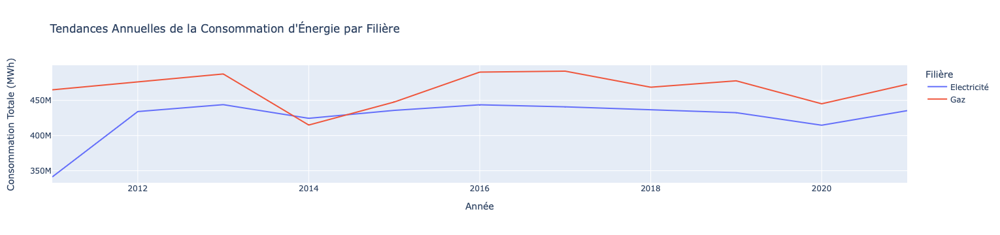

In [12]:
import plotly.express as px
import pandas as pd

# Chargement des données
data = pd.read_csv('conso-elec-gaz-annuelle-par-secteur-dactivite-agregee-commune.csv', sep=';')

# Préparation des données pour le graphique
annual_consumption = data.groupby(['annee', 'filiere']).agg({'consototale': 'sum'}).reset_index()

# Création du graphique
fig = px.line(annual_consumption, x='annee', y='consototale', color='filiere',
              title='Tendances Annuelles de la Consommation d\'Énergie par Filière',
              labels={'consototale': 'Consommation Totale (MWh)', 'annee': 'Année', 'filiere': 'Filière'})
fig.show()


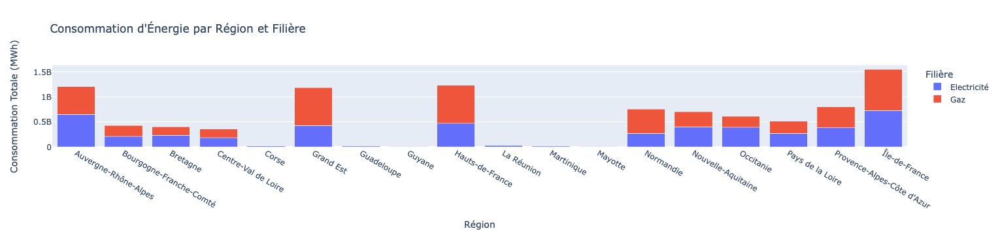

In [13]:
# Préparation des données pour le graphique
regional_consumption = data.groupby(['libelle_region', 'filiere']).agg({'consototale': 'sum'}).reset_index()

# Création du graphique
fig = px.bar(regional_consumption, x='libelle_region', y='consototale', color='filiere',
             title='Consommation d\'Énergie par Région et Filière',
             labels={'consototale': 'Consommation Totale (MWh)', 'libelle_region': 'Région', 'filiere': 'Filière'})
fig.show()

Corrélation entre la Consommation d'Énergie et le Nombre de Points de Livraison : Un graphique de dispersion (scatter plot) pour chaque secteur, montrant la relation entre la consommation d'énergie et le nombre de points de livraison.

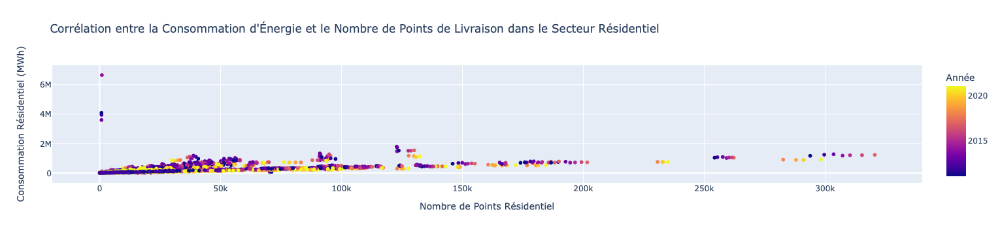

In [14]:
# Préparation des données pour le graphique
scatter_data = data[['consor', 'pdlr', 'annee']].dropna()

# Création du graphique
fig = px.scatter(scatter_data, x='pdlr', y='consor', color='annee',
                 title='Corrélation entre la Consommation d\'Énergie et le Nombre de Points de Livraison dans le Secteur Résidentiel',
                 labels={'consor': 'Consommation Résidentiel (MWh)', 'pdlr': 'Nombre de Points Résidentiel', 'annee': 'Année'})
fig.show()


In [15]:
df_energie.head()

,operateur,annee,filiere,consoa,pdla,nombre_maille_secretisees_a,indquala,consoi,pdli,nombre_maille_secretisees_i,...,libelle_commune,code_epci,libelle_epci,code_departement,libelle_departement,code_region,libelle_region,id_filiere,consototale,code_postal
0,GRDF,2021,Gaz,0.0,0,0,0.0,0.00000,0,1,...,Armeau,248900334,CA du Grand Sénonais,89,Yonne,27,Bourgogne-Franche-Comté,200,2317.51553,89500
1,GRDF,2021,Gaz,0.0,0,0,0.0,0.00000,0,1,...,Branches,200067114,CA de l'Auxerrois,89,Yonne,27,Bourgogne-Franche-Comté,200,1905.29787,89113
2,GRDF,2021,Gaz,0.0,0,0,0.0,1895.35634,9,0,...,Brienon-sur-Armançon,200067304,CC Serein et Armance,89,Yonne,27,Bourgogne-Franche-Comté,200,16756.07274,89210/89210
3,GRDF,2021,Gaz,0.0,0,0,0.0,0.00000,0,0,...,Brion,248900938,CC du Jovinien,89,Yonne,27,Bourgogne-Franche-Comté,200,1696.15670,89400
4,GRDF,2021,Gaz,0.0,0,1,0.0,0.00000,0,0,...,La Celle-Saint-Cyr,248900938,CC du Jovinien,89,Yonne,27,Bourgogne-Franche-Comté,200,4395.90677,89116
